# Baseline
This file looks into the 1st and 2nd baselines that will be improved upon using deep learning models and also answers the questions below.
- Are any of the common practices useful in analyzing the content itself?
- What are the effects of emojis on prediction outcomes?


The following codes below are required to install the packages to access some of its libraries, the libraries imported are necessary to be used later in this project.

In [ ]:
pip install scikit-multilearn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 89 kB 3.6 MB/s 


In [ ]:
pip install gensim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install emoji

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 197 kB 5.1 MB/s 
  Created wheel for emoji: filename=emoji-2.0.0-py3-none-any.whl size=193022 sha256=2bcb013386b1ecfe32223560788ef0113022d1e98ec3cd12f6fbcb1df3521f93
  Stored in directory: /root/.cache/pip/wheels/ec/29/4d/3cfe7452ac7d8d83b1930f8a6205c3c9649b24e80f9029fc38
Successfully built emoji


In [ ]:
pip install clean-text

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 175 kB 5.0 MB/s 
     |████████████████████████████████| 53 kB 1.8 MB/s 
  Created wheel for emoji: filename=emoji-1.7.0-py3-none-any.whl size=171046 sha256=45517fe6173ee475a9a0ecdbcfb3757cc2913849aa9a63be58c789be098ffb00
  Stored in directory: /root/.cache/pip/wheels/8a/4e/b6/57b01db010d17ef6ea9b40300af725ef3e210cb1acfb7ac8b6
Successfully built emoji
  Attempting uninstall: emoji
    Found existing installation: emoji 2.0.0
    Uninstalling emoji-2.0.0:
      Successfully uninstalled emoji-2.0.0


In [ ]:
#required libraries imported to run project
import nltk
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import emoji
import re
import nltk
import regex
import seaborn as sns
import skmultilearn
from collections import Counter
from sklearn.pipeline import Pipeline
from bs4 import BeautifulSoup
from nltk.corpus import stopwords
from matplotlib import pyplot as plt
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.multioutput import MultiOutputClassifier
from sklearn.multiclass import OneVsRestClassifier
from skmultilearn.problem_transform import BinaryRelevance
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction import text
from sklearn.linear_model import LogisticRegression
from gensim.models import Word2Vec
from sklearn.decomposition import PCA
from skmultilearn.model_selection.measures import get_combination_wise_output_matrix
from sklearn.metrics import classification_report,confusion_matrix,balanced_accuracy_score,cohen_kappa_score,roc_auc_score

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('omw-1.4')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

# **Assembling a Dataset**

In this project, we will be using the full GoEmotions dataset from Kaggle to perform our feature extraction. As the dataset is split into 3 tab-separated values (tsv) files, we will concatenate them together and re-index the dataframe to create the full dataset containing all text data and emotion labels.

From the dataset, we will be predicting if a sample text is considered abusive which allows us to perform content filtering. From the present emotion labels, we can see that there are positive and negative emotions detected. As such, the negative emotions can be deemed as abusive while positive emotions can be deemed as non-abusive. This is because with texts with negative emotions tend towards having negative connotations, making them more suited to be under the abusive category.


In [ ]:
train_df = pd.read_csv("dataset/train.tsv",sep='\t')
val_df = pd.read_csv("dataset/dev.tsv",sep='\t')
test_df = pd.read_csv("dataset/test.tsv",sep='\t')

In [ ]:
dataset=pd.concat([train_df,val_df, test_df], axis=0)
dataset = dataset.reset_index(drop=True)

In [ ]:
dataset.head(3)

,text,emotion,id
0,My favourite food is anything I didn't have to...,27,eebbqej
1,"Now if he does off himself, everyone will thin...",27,ed00q6i
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj


We need to perform emotion mapping to show the emotions present in each sample of data text. This is done though the use of "ekman_mapping" and the "emotion_list" which contains all 29 emotion labels including the neutral emotion.

In [ ]:
dataset['List of classes'] = dataset['emotion'].apply(lambda x: x.split(','))

In [ ]:
import json
with open('dataset/ekman_mapping.json') as file:
    ekman_mapping = json.load(file)

emotion_file = open("dataset/emotions.txt", "r")
emotion_list = emotion_file.read()
emotion_list = emotion_list.split("\n")
print(emotion_list)

['admiration', 'amusement', 'anger', 'annoyance', 'approval', 'caring', 'confusion', 'curiosity', 'desire', 'disappointment', 'disapproval', 'disgust', 'embarrassment', 'excitement', 'fear', 'gratitude', 'grief', 'joy', 'love', 'nervousness', 'optimism', 'pride', 'realization', 'relief', 'remorse', 'sadness', 'surprise', 'neutral']


In [ ]:
def idx2class(idx_list):
    arr = []
    for i in idx_list:
        arr.append(emotion_list[int(i)])
    return arr

def EmotionMapping(emotion_list):
    map_list = []
    
    for i in emotion_list:
        if i in ekman_mapping['anger']:
            map_list.append('anger')
        if i in ekman_mapping['disgust']:
            map_list.append('disgust')
        if i in ekman_mapping['fear']:
            map_list.append('fear')
        if i in ekman_mapping['joy']:
            map_list.append('joy')
        if i in ekman_mapping['sadness']:
            map_list.append('sadness')
        if i in ekman_mapping['surprise']:
            map_list.append('surprise')
        if i == 'neutral':
            map_list.append('neutral')
            
    return map_list

In [ ]:
dataset['Emotions'] = dataset['List of classes'].apply(idx2class)

The emotions contained within each sample text is shown in Emotions. At this stage, there are still a total of 28 emotion labels including neutral.

In [ ]:
dataset.head(3)

,text,emotion,id,List of classes,Emotions
0,My favourite food is anything I didn't have to...,27,eebbqej,[27],[neutral]
1,"Now if he does off himself, everyone will thin...",27,ed00q6i,[27],[neutral]
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj,[2],[anger]


In [ ]:
dataset['Mapped Emotions'] = dataset['Emotions'].apply(EmotionMapping)

After mapping is performed, we now only have 6 major emotion labels and neutral. They are mainly anger, sadness, fear, joy, disgust and surprise.

In [ ]:
dataset.head()

,text,emotion,id,List of classes,Emotions,Mapped Emotions
0,My favourite food is anything I didn't have to...,27,eebbqej,[27],[neutral],[neutral]
1,"Now if he does off himself, everyone will thin...",27,ed00q6i,[27],[neutral],[neutral]
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj,[2],[anger],[anger]
3,To make her feel threatened,14,ed7ypvh,[14],[fear],[fear]
4,Dirty Southern Wankers,3,ed0bdzj,[3],[annoyance],[anger]


Following which , we perform one-hot encoding on the "Mapped Emotions" column to display the emotions of each text and to perform classification.

In [ ]:
one_hot = MultiLabelBinarizer()
y = pd.DataFrame(one_hot.fit_transform(dataset['Mapped Emotions']), columns=one_hot.classes_)
dataset = dataset.join(y)

In [ ]:
dataset.head(3)

,text,emotion,id,List of classes,Emotions,Mapped Emotions,anger,disgust,fear,joy,neutral,sadness,surprise
0,My favourite food is anything I didn't have to...,27,eebbqej,[27],[neutral],[neutral],0,0,0,0,1,0,0
1,"Now if he does off himself, everyone will thin...",27,ed00q6i,[27],[neutral],[neutral],0,0,0,0,1,0,0
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj,[2],[anger],[anger],1,0,0,0,0,0,0


In [ ]:
#drop any coluns that we will not be using
dataset.drop(['emotion', 'id','List of classes', 'Emotions','Mapped Emotions'], axis=1, inplace=True)

# **Data Exploration**

In [ ]:
# Display a description of the dataset
display(dataset.describe())

,anger,disgust,fear,joy,neutral,sadness,surprise
count,54263.000000,54263.000000,54263.000000,54263.000000,54263.000000,54263.000000,54263.000000
mean,0.129407,0.018668,0.017120,0.400512,0.327516,0.074305,0.122883
std,0.335653,0.135352,0.129721,0.490007,0.469312,0.262269,0.328306
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
#Dataset contains 211225 rows and 37 columns.
dataset.shape

(54263, 8)

In [ ]:
dataset.columns

Index(['text', 'anger', 'disgust', 'fear', 'joy', 'neutral', 'sadness',
       'surprise'],
      dtype='object')

In [ ]:
#check that dataset does not contain any missing values
count = dataset.isna().sum()
precentange = dataset.isna().mean().round(4) * 100

dfMissing = pd.DataFrame({'count': count, 'precentange': precentange})
dfMissing.sort_values('count', ascending=False)

,count,precentange
text,0,0.0
anger,0,0.0
disgust,0,0.0
fear,0,0.0
joy,0,0.0
neutral,0,0.0
sadness,0,0.0
surprise,0,0.0


The emotion neutral is diffcult to infer whether the text is abusive or non-abusive. Hence, we will exlude this class and related data points from the project.

In [ ]:
#drop any columns that we will not be using
dataset = dataset.drop(dataset[dataset.neutral == 1].index)
dataset.drop(['neutral'], axis=1, inplace =True)
dataset=dataset.reset_index(drop=True)

In [ ]:
dataset

,text,anger,disgust,fear,joy,sadness,surprise
0,WHY THE FUCK IS BAYLESS ISOING,1,0,0,0,0,0
1,To make her feel threatened,0,0,1,0,0,0
2,Dirty Southern Wankers,1,0,0,0,0,0
3,OmG pEyToN iSn'T gOoD eNoUgH tO hElP uS iN tHe...,0,0,0,0,0,1
4,Yes I heard abt the f bombs! That has to be wh...,0,0,0,1,0,0
...,...,...,...,...,...,...,...
36486,"That’s what I’m thinking too, so I may just go...",0,0,0,1,0,0
36487,My mom works for Nasa and apparently no. They ...,0,1,0,1,0,0
36488,Thanks. I was diagnosed with BP 1 after the ho...,0,0,0,1,0,0
36489,Well that makes sense.,0,0,0,1,0,0


In [ ]:
#data distribution
temp_list = dataset.drop(['text'], axis=1).sum(axis=0).tolist()
emotions = 'anger','disgust','fear','joy','sadness', 'surprise'
trace1 = go.Bar(
                x = emotions,
                y = temp_list,
                marker = dict(color = 'rgb(127, 16, 238)',
                              line=dict(color='rgb(0,0,0)',width=1.5)),
                text=temp_list, textposition='outside')
layout = go.Layout(template= "plotly_dark",title = 'NUMBER OF EMOTIONS' , xaxis = dict(title = 'Emotion'), yaxis = dict(title = 'Count'))
fig = go.Figure(data = [trace1], layout = layout)
fig.show()

In [ ]:
emotion_list = ['anger','disgust','fear','joy','sadness', 'surprise']
y_labels = dataset[emotion_list]

We can see the distribution of classes and how many texts belong to a single class or more than one class (multi-labelled)

In [ ]:
pd.DataFrame({
    'multi-label': Counter(str(combination) for row in get_combination_wise_output_matrix(np.asmatrix(y_labels).A, order=2) for combination in row)
}).T.fillna(0.0)

,"(0, 0)","(0, 1)","(0, 2)","(0, 3)","(0, 4)","(0, 5)","(1, 1)","(1, 2)","(1, 3)","(1, 4)",...,"(2, 2)","(2, 3)","(2, 4)","(2, 5)","(3, 3)","(3, 4)","(3, 5)","(4, 4)","(4, 5)","(5, 5)"
multi-label,6630,193,28,459,322,258,980,19,73,53,...,892,78,48,45,20975,423,974,3867,202,6273


# **Data Cleaning**

The dataset does not contain duplicated data, hence we will only be performing textual data cleaning

In [ ]:
# A list of contractions from http://stackoverflow.com/questions/19790188/expanding-english-language-contractions-in-python
contractions_map = { 
"ain't": "am not",
"aren't": "are not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he would",
"he'd've": "he would have",
"he'll": "he will",
"he's": "he is",
"how'd": "how did",
"how'll": "how will",
"how's": "how is",
"i'd": "i would",
"i'll": "i will",
"i'm": "i am",
"i've": "i have",
"isn't": "is not",
"it'd": "it would",
"it'll": "it will",
"it's": "it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"must've": "must have",
"mustn't": "must not",
"needn't": "need not",
"oughtn't": "ought not",
"shan't": "shall not",
"sha'n't": "shall not",
"she'd": "she would",
"she'll": "she will",
"she's": "she is",
"should've": "should have",
"shouldn't": "should not",
"that'd": "that would",
"that's": "that is",
"there'd": "there had",
"there's": "there is",
"they'd": "they would",
"they'll": "they will",
"they're": "they are",
"they've": "they have",
"wasn't": "was not",
"we'd": "we would",
"we'll": "we will",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what will",
"what're": "what are",
"what's": "what is",
"what've": "what have",
"where'd": "where did",
"where's": "where is",
"who'll": "who will",
"who's": "who is",
"won't": "will not",
"wouldn't": "would not",
"you'd": "you would",
"you'll": "you will",
"you're": "you are"
}

The functions below perform Natural Language Processing for Machine Learning, this can also be known as pre-processing data by cleaning the data. This highlights the more crucial attributes of the data. 

In [ ]:
#map any detected contractions to their longer forms for easier processing of individual words/features
def contractions(text, mapping):
    '''Clean contraction using contraction mapping'''    
    specials = ["’", "‘", "´", "`"]
    for s in specials:
        text = text.replace(s, "'")
    for word in mapping.keys():
        if ""+word+"" in text:
            text = text.replace(""+word+"", ""+mapping[word]+"")
    return text

#function to clean text data (data cleaning/processing)
def clean_text(text, remove_stopwords=True):
    text = emoji.demojize(text)
    text = text.lower()

    template = re.compile(r'https?://\S+|www\.\S+') #Removes website links
    text = template.sub(r'', text)
    text = contractions(text, contractions_map)
    
    soup = BeautifulSoup(text, 'lxml') #Removes HTML tags
    only_text = soup.get_text()
    text = only_text
    text = re.sub(r'\<a href', ' ', text)
    text = re.sub(r"[^a-zA-Z\d]", " ", text) #Remove special Charecters
    text = re.sub(r'&amp;', '', text) 
    text = re.sub(' +', ' ', text) #Remove Extra Spaces
    text = text.strip() # remove spaces at the beginning and at the end of string 

    
    # remove stopwords
    if remove_stopwords:
        text = text.split()
        stops = set(stopwords.words("english"))
        text = [w for w in text if not w in stops]
        text = " ".join(text)

    # Tokenize each word
    text =  nltk.WordPunctTokenizer().tokenize(text)
    
    # Lemmatize each token
    lemm = nltk.stem.WordNetLemmatizer()
    text = list(map(lambda word:list(map(lemm.lemmatize, word)), text))
    words = [*map(''.join, text)]
    full_test = [*map(''.join, words)]
    return full_test

#find all emojis using regex and generates a list of emojis found in text
def split_count(text):
    emoji_list = []
    data = regex.findall(r'\X', text)
    for word in data:
        if any(char in emoji.distinct_emoji_list(char) for char in word):
            emoji_list.append(word)
    return emoji_list

We can see the number of emojis found and its respective type of emoji in the entire dataset.

In [ ]:
text = dataset['text']
emoji_list= [] 
for t in text:
  emoji_list=emoji_list+split_count(t)

print(Counter(emoji_list))

Counter({'😂': 251, '❤️': 75, '🤣': 57, '😭': 45, '😍': 34, '❤': 30, '🦀': 29, '🤔': 28, '😊': 28, '👍': 25, '👏': 25, '😢': 21, '😅': 20, '😎': 20, '💜': 17, '😁': 16, '🙄': 16, '🔥': 16, '♥️': 15, '👌': 14, '🙏': 14, '💦': 14, '😉': 14, '💕': 13, '💯': 13, '😔': 12, '🤢': 12, '🙃': 10, '😆': 10, '☺️': 9, '😏': 9, '😘': 8, '😀': 8, '☺': 8, '♀️': 8, '👀': 8, '😤': 8, '🤗': 7, '😐': 7, '🎉': 7, '🤮': 7, '🤷\u200d♀️': 6, '😄': 6, '💖': 6, '💙': 6, '🎶': 6, '✔️': 6, '👌🏼': 6, '😬': 6, '🔪': 6, '😪': 5, '😥': 5, '💃': 5, '😣': 5, '😩': 5, '💅🏻': 5, '☹': 5, '👍🏻': 5, '🎂': 4, '🙂': 4, '💓': 4, '✌': 4, '🚫': 4, '😞': 4, '💎': 4, '😑': 4, '🤦🏻\u200d♀️': 4, '😖': 4, '🏊\u200d♂️': 4, '🙏🏽': 4, '🏳️\u200d🌈': 4, '😜': 3, '👑': 3, '😳': 3, '🤪': 3, '😫': 3, '🤩': 3, '👊': 3, '💛': 3, '💚': 3, '😒': 3, '🌈': 3, '👩': 3, '✨': 3, '🙌': 3, '👍🏼': 3, '🙌🏻': 3, '♥': 3, '💗': 3, '🥀': 3, '🚓': 3, '🍩': 3, '☹️': 3, '🤷🏼\u200d♀️': 3, '😰': 3, '🤷': 3, '🤷\u200d♂️': 3, '👅': 3, '😝': 2, '🍻': 2, '🤠': 2, '🦈': 2, '😃': 2, '😮': 2, '❣️': 2, '💄': 2, '👸': 2, '💥': 2, '🤦\u200d♂️': 2, '🤷🏻\u200d♀️': 2, '

In [ ]:
#create a copy of the current dataframe to have 2 dataframes
#dataset: considers the presence of emojis by converting them to words
#no_emoji_df: does not consider the presence of emojis, removes them 

no_emoji_df = dataset.copy()
no_emoji_df=no_emoji_df.astype(str).apply(lambda x: x.str.encode('ascii', 'ignore').str.decode('ascii'))

#check that there are no long any emojis
text = no_emoji_df['text']
emoji_list= [] 
for t in text:
  emoji_list=emoji_list+split_count(t)

#checks for any emojis
print(Counter(emoji_list))

Counter()


In [ ]:
#generate cleaned words and text - df with emoji words
dataset['words'] = dataset.text.apply(clean_text)
temp=list(dataset['words'])
dataset['filtered'] = [*map(' '.join, temp)]

#generate cleaned words and text - df without emoji words
no_emoji_df['words'] = no_emoji_df.text.apply(clean_text)
temp=list(no_emoji_df['words'])
no_emoji_df['filtered'] = [*map(' '.join, temp)]

In [ ]:
no_emoji_df

,text,anger,disgust,fear,joy,sadness,surprise,words,filtered
0,WHY THE FUCK IS BAYLESS ISOING,1,0,0,0,0,0,"[fuck, bayless, isoing]",fuck bayless isoing
1,To make her feel threatened,0,0,1,0,0,0,"[make, feel, threatened]",make feel threatened
2,Dirty Southern Wankers,1,0,0,0,0,0,"[dirty, southern, wankers]",dirty southern wankers
3,OmG pEyToN iSn'T gOoD eNoUgH tO hElP uS iN tHe...,0,0,0,0,0,1,"[omg, peyton, good, enough, help, us, playoffs...",omg peyton good enough help us playoffs dumbas...
4,Yes I heard abt the f bombs! That has to be wh...,0,0,0,1,0,0,"[yes, heard, abt, f, bombs, thanks, reply, hub...",yes heard abt f bombs thanks reply hubby anxio...
...,...,...,...,...,...,...,...,...,...
36486,"Thats what Im thinking too, so I may just go w...",0,0,0,1,0,0,"[thats, im, thinking, may, go, referral, thank...",thats im thinking may go referral thanks help
36487,My mom works for Nasa and apparently no. They ...,0,1,0,1,0,0,"[mom, works, nasa, apparently, gave, pamphlets...",mom works nasa apparently gave pamphlets numbe...
36488,Thanks. I was diagnosed with BP 1 after the ho...,0,0,0,1,0,0,"[thanks, diagnosed, bp, 1, hospitalization, well]",thanks diagnosed bp 1 hospitalization well
36489,Well that makes sense.,0,0,0,1,0,0,"[well, makes, sense]",well makes sense


# **Evaluation Methodology**
From the diagram above, it shows that the 26 classes have different counts. This shows that the classes are not balanced, hence we need to use valid evaluation metrics as our evaluation methodology to obtain accurate classification.

In order to prove that our classifier works, we will be using various metrices.

- Prediction to predict the class/label of the text, we will check if the predicted emotion is in the top 3.
- Confusion matrix which is a breakdown of predictions into a table showing correct predictions and the types of incorrect predictions made, predictions in the diagonal section of the table are the correct predictions.
- F1 Score is a weighted average of precision and recall.
- Cohen’s kappa is the classification accuracy normalized by the imbalance of the classes in the data.
- Area Under the ROC curve (AUC – ROC) is a performance measurement for the classification problems at various threshold settings.

In [ ]:
def evaluation_metrics(y_test, y_pred, classifier, test_text):
    cfn_mat = confusion_matrix(y_pred, y_test)
    prob_prediction = classifier.predict_proba(test_text)
    top_3 = np.argsort(prob_prediction[0])[:-4:-1]
    print("confusion matrix: \n",cfn_mat)
    print("\nbalanced accuracy: ",balanced_accuracy_score(y_pred, y_test))
    print("\ncohen's kappa score: ",cohen_kappa_score(y_pred, y_test))
    print("\ntop 3 predicted labels: ",top_3)
    print("\nclassification report: \n", classification_report(y_pred, y_test))

In [ ]:
def calculate_roc_auc(y_test, y_prob):

    macro_roc_auc_ovo = roc_auc_score(y_test, y_prob, multi_class="ovo", average="macro")
    weighted_roc_auc_ovo = roc_auc_score(y_test, y_prob, multi_class="ovo", average="weighted")

    macro_roc_auc_ovr = roc_auc_score(y_test, y_prob, multi_class="ovr", average="macro")
    weighted_roc_auc_ovr = roc_auc_score(y_test, y_prob, multi_class="ovr", average="weighted")

    print(
        "One-vs-One ROC AUC scores:\n{:.6f} (macro),\n{:.6f} "
        "(weighted by prevalence)".format(macro_roc_auc_ovo, weighted_roc_auc_ovo)
    )
    print(
        "One-vs-Rest ROC AUC scores:\n{:.6f} (macro),\n{:.6f} "
        "(weighted by prevalence)".format(macro_roc_auc_ovr, weighted_roc_auc_ovr)
    )

# **Baseline performance** 

### **Random Guess/Naive Model**
We can give an estimated probability of correctly classifying the text to the label without the use of any model, this is referred to random guess/naive model which can be performed by any individual. We will take a look at a baseline without referencing the dataset but simply by looking at the labels/classes present, in this case we will look at "anger, disgust, fear, joy, sadness, surprise". As there are a total of 6 labels, from classes 0 to 5, for each emotion. By proability, the percentage of accuracy is 16.67% at best where 100%/6 = 16.67% (2 decimal places).

Another guess would be at a lower probability of 2.78% when taking into consideration of the multi-label dataset where a sample text can belong to 2 different classes. This is achieved by 1/36 * 100 = 2.78% (2 decimal places).

### **Abusive VS Non-Abusive**

Another method of obtaining our baseline is through a direct approach of simply categorizing the emotions into sub-groups of abusive or non-abusive, a random guess would generate 50%. However, we are also interested in how text representation will affect the classification. Hence, we will generate results by passing them through logistic regression.

In [ ]:
#using negative emotions as a subgroup, label texts into abusive(1) and non-abusive(0)
negative_cols=['anger','disgust','fear', 'sadness']

df_emoji = dataset.copy()
df_emoji['abusive'] = df_emoji[negative_cols].sum(axis=1)
#for instances of more than 1 negative emotion
df_emoji['abusive'] = np.where(df_emoji['abusive'] != 0 , 1, 0)

df_without_emoji = no_emoji_df.copy()
df_without_emoji['abusive'] = df_without_emoji[negative_cols].sum(axis=1)
#for instances of more than 1 negative emotion
df_without_emoji['abusive'] = np.where(df_without_emoji['abusive'] != 0 , 1, 0)

In [ ]:
df_emoji.head(3)

,text,anger,disgust,fear,joy,sadness,surprise,words,filtered,abusive
0,WHY THE FUCK IS BAYLESS ISOING,1,0,0,0,0,0,"[fuck, bayless, isoing]",fuck bayless isoing,1
1,To make her feel threatened,0,0,1,0,0,0,"[make, feel, threatened]",make feel threatened,1
2,Dirty Southern Wankers,1,0,0,0,0,0,"[dirty, southern, wankers]",dirty southern wankers,1


In [ ]:
drop_col = ['anger','disgust','fear','joy','sadness','surprise','words']
df_emoji.drop(drop_col, axis=1, inplace=True)
df_without_emoji.drop(drop_col, axis=1, inplace=True)

In [ ]:
df_without_emoji.head(3)

,text,filtered,abusive
0,WHY THE FUCK IS BAYLESS ISOING,fuck bayless isoing,1
1,To make her feel threatened,make feel threatened,1
2,Dirty Southern Wankers,dirty southern wankers,1


#### **Fit_Transform VS Transform**

When performing Bag of Words and TF-IDF, we will only use fit_transform on the train data and transform on the test data. This is because we do not want Logistic Regresion to ask for classification based on the features input. As our training and test features are different (different texts which results in different words and different number of words present), the test data would reflect a different vocabulary compared to the training data vocabulary which the model is trained on.


## **On dataset considering the representation of emojis**

### **Bag of Words (BoW)**
A bag-of-words (BoW) is a representation of text that describes the appearance of a unique word within a text, without consideration of the word order but only the occurences of a unique word. Hence, all words are independent from each other. Each unique word in the dictionary will correspond to a (descriptive) feature.

In [ ]:
training_data, test_data = train_test_split(df_emoji, train_size = 0.7, random_state=42)

binary_x_train = training_data['filtered']
binary_x_test = test_data['filtered']

binary_y_train = training_data['abusive']
binary_y_test = test_data['abusive']

In [ ]:
print(binary_x_train.shape)
print(binary_x_test.shape)

print(binary_y_train.shape)
print(binary_y_test.shape)

(25543,)
(10948,)
(25543,)
(10948,)


We have passing in a pre-defined list of stop words form the English language that we do not want in our vocabulary.

In [ ]:
count_vect = CountVectorizer(stop_words = "english")
X_train_bow= count_vect.fit_transform(binary_x_train)
X_test_bow = count_vect.transform(binary_x_test)

In [ ]:
print(len(count_vect.vocabulary_))
print(X_train_bow.shape)
print(X_test_bow.shape)

18806
(25543, 18806)
(10948, 18806)


In [ ]:
lg=LogisticRegression()
lg.fit(X_train_bow, binary_y_train)
y_pred = lg.predict(X_test_bow)
test_text = count_vect.transform(['man love reddit'])

evaluation_metrics(binary_y_test, y_pred, lg, test_text)

confusion matrix: 
 [[6761 1368]
 [ 620 2199]]

balanced accuracy:  0.8058887351705609

cohen's kappa score:  0.5629872806119094

top 3 predicted labels:  [0 1]

classification report: 
               precision    recall  f1-score   support

           0       0.92      0.83      0.87      8129
           1       0.62      0.78      0.69      2819

    accuracy                           0.82     10948
   macro avg       0.77      0.81      0.78     10948
weighted avg       0.84      0.82      0.82     10948



/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [ ]:
calculate_roc_auc(binary_y_test, y_pred)

One-vs-One ROC AUC scores:
0.766242 (macro),
0.766242 (weighted by prevalence)
One-vs-Rest ROC AUC scores:
0.766242 (macro),
0.766242 (weighted by prevalence)


#### **BoW - Example**
Below shows a dataframe containing the top 1500 most frequently used words in the dataset.

In [ ]:
#The column names represent the token and rows represent individual sentences. 
#If that token is present in the sentence, the respective column will have a value 1, otherwise 0.
count_vect_example = CountVectorizer(max_features = 1500, stop_words = "english")
count_example= count_vect_example.fit_transform(dataset['filtered'])
countdf_example = pd.DataFrame(data = count_example.toarray(), index = dataset.index)
countdf_example.columns = count_vect_example.get_feature_names()
countdf_example

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



,000,10,100,11,12,14,15,16,18,1st,...,yes,yesterday,yikes,yo,young,younger,youre,youtube,yup,zero
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36486,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
36487,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
36488,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
36489,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### **Analysis**

However, as BoW simply counts the number of words in each text, it will give greater weightage to longer texts compared to shorter ones. Hence, we will also take a look at TF-IDF which takes into consideration common words such as word articles.

### **TF-IDF**
Term Frequency–Inverse Document Frequency, represents the importance of each word is to a given document within a set of documents. It is a statistical measure that evaluates the relative frequency of a word in a document (Term Frequency) and the relative count of documents containing the word generated as a "log" (Inverse Document Frequency).

The importance increases proportionally to the number of times a word appears in the document but is offset by the frequency of the word in the corpus.

Similarly to Bag-of-Words, each word is independent of other words. However, unlike BoW model that contains the count of word occurences in a document, TF-IDF model contains information on both the important and less important words as well.

As we had used Count Vectorizer above in BoW, we can simply use TFIDF Transformer on the vectorized data. TFIDF Vectorizer is not used here as does what Count Vectorizer and TFIDF Transformer can do at once. 

In [ ]:
tfidf_transform = TfidfTransformer()
X_train_tfidf = tfidf_transform.fit_transform(X_train_bow)
X_test_tfidf = tfidf_transform.transform(X_test_bow)

print(X_train_tfidf.shape)
print(X_test_tfidf.shape)

(25543, 18806)
(10948, 18806)


In [ ]:
lg=LogisticRegression()
lg.fit(X_train_tfidf, binary_y_train)
y_pred = lg.predict(X_test_tfidf)
test_text = tfidf_transform.transform(test_text)

evaluation_metrics(binary_y_test, y_pred, lg,test_text)

confusion matrix: 
 [[6958 1612]
 [ 423 1955]]

balanced accuracy:  0.8170107058773883

cohen's kappa score:  0.5370195195432335

top 3 predicted labels:  [0 1]

classification report: 
               precision    recall  f1-score   support

           0       0.94      0.81      0.87      8570
           1       0.55      0.82      0.66      2378

    accuracy                           0.81     10948
   macro avg       0.75      0.82      0.77     10948
weighted avg       0.86      0.81      0.83     10948



In [ ]:
calculate_roc_auc(binary_y_test, y_pred)

One-vs-One ROC AUC scores:
0.745385 (macro),
0.745385 (weighted by prevalence)
One-vs-Rest ROC AUC scores:
0.745385 (macro),
0.745385 (weighted by prevalence)


#### **TF-IDF - Example**
Below shows a dataframe containing the top 1500 most frequently used words in the dataset.

In [ ]:
tfidf_vect_example = TfidfVectorizer(stop_words='english', max_features = 1500) 
tfidf_example = tfidf_vect_example.fit_transform(dataset['filtered']) 
tfidf_df_example = pd.DataFrame(tfidf_example.A, columns=tfidf_vect_example.get_feature_names())
tfidf_df_example

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



,000,10,100,11,12,14,15,16,18,1st,...,yes,yesterday,yikes,yo,young,younger,youre,youtube,yup,zero
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.331533,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36486,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36487,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36488,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36489,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### **Analysis - TFIDF**
TF-IDF alongside with BoW do not take into consideration the sequence of words, hence we will take a look at word embeddings.

### **Word Embeddings**

Word Embeddings are a method of extracting features out of text so that we can input those features into a machine learning model to work with text data. 

This target the disadvantage of the baselines above which does not take into account the word sequence in the text.

In [ ]:
#generate vectors from corpus
w2v_model = Word2Vec(dataset.words, min_count=1,size=300, iter=100)
words = list(w2v_model.wv.vocab)

In [ ]:
len(words)

22852

In [ ]:
#using the PCA model we can obtain the x and y values of each word by flattening the vectors
X = w2v_model[w2v_model.wv.vocab]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
pca_df = pd.DataFrame(result, columns = ['x','y'])
pca_df['word'] = words
pca_df.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning:

Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).



,x,y,word
0,-0.322895,1.057580,fuck
1,0.671722,-0.184127,bayless
2,0.082468,0.062363,isoing
3,-1.444368,2.540321,make
4,-0.292705,4.047512,feel


In [ ]:
N = 1000000
fig = go.Figure(data=go.Scattergl(
    x = pca_df['x'],
    y = pca_df['y'],
    mode='markers',
    marker=dict(
        color=np.random.randn(N),
        colorscale='Viridis',
        line_width=1
    ),
    text=pca_df['word'],
    textposition="bottom center"
))
fig.show()

In [ ]:
class MyTokenizer:
    def __init__(self):
        pass
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
        for document in X:
            tokenized_doc = []
            for sent in nltk.sent_tokenize(document):
                tokenized_doc += nltk.word_tokenize(sent)
            transformed_X.append(np.array(tokenized_doc))
        return np.array(transformed_X)
    
    def fit_transform(self, X, y=None):
        return self.transform(X)

class MeanEmbeddingVectorizer(object):
    def __init__(self, word2vec):
        self.word2vec = word2vec
        # if a text is empty we should return a vector of zeros
        # with the same dimensionality as all the other vectors
        self.dim = len(word2vec.wv.syn0[0])

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X = MyTokenizer().fit_transform(X)
        
        return np.array([
            np.mean([self.word2vec.wv[w] for w in words if w in self.word2vec.wv]
                    or [np.zeros(self.dim)], axis=0)
            for words in X
        ])
    
    def fit_transform(self, X, y=None):
        return self.transform(X)

In [ ]:
mean_embedding_vect = MeanEmbeddingVectorizer(w2v_model)
X_train_we = mean_embedding_vect.fit_transform(binary_x_train)
X_test_we = mean_embedding_vect.transform(binary_x_test)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: DeprecationWarning:

Call to deprecated `syn0` (Attribute will be removed in 4.0.0, use self.wv.vectors instead).

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



In [ ]:
lg=LogisticRegression()
lg.fit(X_train_we, binary_y_train)
y_pred = lg.predict(X_test_we)
test_text = mean_embedding_vect.transform(['man love reddit'])

evaluation_metrics(binary_y_test, y_pred,lg, test_text)

confusion matrix: 
 [[6629 1652]
 [ 752 1915]]

balanced accuracy:  0.7592712153584352

cohen's kappa score:  0.465316025974122

top 3 predicted labels:  [0 1]

classification report: 
               precision    recall  f1-score   support

           0       0.90      0.80      0.85      8281
           1       0.54      0.72      0.61      2667

    accuracy                           0.78     10948
   macro avg       0.72      0.76      0.73     10948
weighted avg       0.81      0.78      0.79     10948



/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [ ]:
calculate_roc_auc(binary_y_test, y_pred)

One-vs-One ROC AUC scores:
0.717491 (macro),
0.717491 (weighted by prevalence)
One-vs-Rest ROC AUC scores:
0.717491 (macro),
0.717491 (weighted by prevalence)


## **On dataset NOT considering the representation of emojis**

### Bag-of-Words

In [ ]:
training_data, test_data = train_test_split(df_without_emoji, train_size = 0.7, random_state=42)

binary_x_train = training_data['filtered']
binary_x_test = test_data['filtered']

binary_y_train = training_data['abusive']
binary_y_test = test_data['abusive']

X_train_bow= count_vect.fit_transform(binary_x_train)
X_test_bow = count_vect.transform(binary_x_test)

In [ ]:
lg=LogisticRegression()
lg.fit(X_train_bow, binary_y_train)
y_pred = lg.predict(X_test_bow)
test_text = count_vect.transform(['man love reddit'])

evaluation_metrics(binary_y_test, y_pred, lg, test_text)

confusion matrix: 
 [[6752 1355]
 [ 629 2212]]

balanced accuracy:  0.8057297878815232

cohen's kappa score:  0.5646001400362297

top 3 predicted labels:  [0 1]

classification report: 
               precision    recall  f1-score   support

           0       0.91      0.83      0.87      8107
           1       0.62      0.78      0.69      2841

    accuracy                           0.82     10948
   macro avg       0.77      0.81      0.78     10948
weighted avg       0.84      0.82      0.82     10948



/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [ ]:
calculate_roc_auc(binary_y_test, y_pred)

One-vs-One ROC AUC scores:
0.767455 (macro),
0.767455 (weighted by prevalence)
One-vs-Rest ROC AUC scores:
0.767455 (macro),
0.767455 (weighted by prevalence)


#### **TF-IDF**

In [ ]:
tfidf_transform = TfidfTransformer()
X_train_tfidf = tfidf_transform.fit_transform(X_train_bow)
X_test_tfidf = tfidf_transform.transform(X_test_bow)

print(X_train_tfidf.shape)
print(X_test_tfidf.shape)

(25543, 18828)
(10948, 18828)


In [ ]:
lg=LogisticRegression()
lg.fit(X_train_tfidf, binary_y_train)
y_pred = lg.predict(X_test_tfidf)
test_text = tfidf_transform.transform(test_text)

evaluation_metrics(binary_y_test, y_pred, lg,test_text)

confusion matrix: 
 [[6938 1586]
 [ 443 1981]]

balanced accuracy:  0.8155906715730231

cohen's kappa score:  0.5400614518786934

top 3 predicted labels:  [0 1]

classification report: 
               precision    recall  f1-score   support

           0       0.94      0.81      0.87      8524
           1       0.56      0.82      0.66      2424

    accuracy                           0.81     10948
   macro avg       0.75      0.82      0.77     10948
weighted avg       0.85      0.81      0.83     10948



/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [ ]:
calculate_roc_auc(binary_y_test, y_pred)

One-vs-One ROC AUC scores:
0.747675 (macro),
0.747675 (weighted by prevalence)
One-vs-Rest ROC AUC scores:
0.747675 (macro),
0.747675 (weighted by prevalence)


### **Word Embeddings**

In [ ]:
#generate vectors from corpus
w2v_model = Word2Vec(no_emoji_df.words, min_count=1,size=300, iter=100)
words = list(w2v_model.wv.vocab)

In [ ]:
mean_embedding_vect = MeanEmbeddingVectorizer(w2v_model)
X_train_we = mean_embedding_vect.fit_transform(binary_x_train)
X_test_we = mean_embedding_vect.transform(binary_x_test)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: DeprecationWarning:

Call to deprecated `syn0` (Attribute will be removed in 4.0.0, use self.wv.vectors instead).

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



In [ ]:
lg=LogisticRegression()
lg.fit(X_train_we, binary_y_train)
y_pred = lg.predict(X_test_we)
test_text = mean_embedding_vect.transform(['man love reddit'])

evaluation_metrics(binary_y_test, y_pred,lg, test_text)

confusion matrix: 
 [[6636 1664]
 [ 745 1903]]

balanced accuracy:  0.7590868307065118

cohen's kappa score:  0.46341400095558616

top 3 predicted labels:  [0 1]

classification report: 
               precision    recall  f1-score   support

           0       0.90      0.80      0.85      8300
           1       0.53      0.72      0.61      2648

    accuracy                           0.78     10948
   macro avg       0.72      0.76      0.73     10948
weighted avg       0.81      0.78      0.79     10948



/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [ ]:
calculate_roc_auc(binary_y_test, y_pred)

One-vs-One ROC AUC scores:
0.716283 (macro),
0.716283 (weighted by prevalence)
One-vs-Rest ROC AUC scores:
0.716283 (macro),
0.716283 (weighted by prevalence)


Comparing the evaluation metrics generated using text representation on dataframes with emoji (df_emoji) and without emoji (df_without_emoji). We can see that the results on dataset with emoji representation is slightly better.

### **Multiclass Classification - OvR**
As seen from the original dataset below, it is multi-label as each sample text may have one or more out of the 6 defined labels. Hence, we can use the OneVsRest (OvR) classifier which is commonly used for either multi-class or multi-label classification. 

OvR performs such that each class is represented by one classifier by splitting the labels into multiple binary classifiction. For example, admiration VS not-admiration, followed by amusement VS not-amusement. This allows us to get a probability for each label.

In [ ]:
dataset.head(3)

,text,anger,disgust,fear,joy,sadness,surprise,words,filtered
0,WHY THE FUCK IS BAYLESS ISOING,1,0,0,0,0,0,"[fuck, bayless, isoing]",fuck bayless isoing
1,To make her feel threatened,0,0,1,0,0,0,"[make, feel, threatened]",make feel threatened
2,Dirty Southern Wankers,1,0,0,0,0,0,"[dirty, southern, wankers]",dirty southern wankers


In [ ]:
train, test = train_test_split(dataset, random_state=42, train_size = 0.7)

X_train = train.filtered
X_test = test.filtered
print("X train shape: ",X_train.shape)
print("X test shape: ",X_test.shape)

#emotion labels - 6 labels
col = ['anger', 'disgust', 'fear', 'joy','sadness', 'surprise']

y_train = train[col]
y_test = test[col]

print("Y train shape: ",y_train.shape)
print("Y test shape: ",y_test.shape)

X train shape:  (25543,)
X test shape:  (10948,)
Y train shape:  (25543, 6)
Y test shape:  (10948, 6)


In [ ]:
ovr = Pipeline([('tfidf', TfidfVectorizer(stop_words='english')),
               ('ovr',OneVsRestClassifier(LogisticRegression(solver='sag',class_weight='balanced', multi_class='multinomial', n_jobs=-1)))
              ])

ovr.fit(X_train, y_train)
y_pred = ovr.predict(X_test)
evaluation_metrics(y_test.values.argmax(axis=1), y_pred.argmax(axis=1),ovr,['said hated dont give damn either way'])

confusion matrix: 
 [[1459  126   62  855  234  472]
 [  89   66   39  295   72   92]
 [  66    7  126  360   74   80]
 [ 218   11    8 4135   85  213]
 [  77    7   16  158  383  108]
 [ 160    6    6  302   57  424]]

balanced accuracy:  0.4288928435318828

cohen's kappa score:  0.4212210226245172

top 3 predicted labels:  [0 4 1]

classification report: 
               precision    recall  f1-score   support

           0       0.71      0.45      0.55      3208
           1       0.30      0.10      0.15       653
           2       0.49      0.18      0.26       713
           3       0.68      0.89      0.77      4670
           4       0.42      0.51      0.46       749
           5       0.31      0.44      0.36       955

    accuracy                           0.60     10948
   macro avg       0.48      0.43      0.43     10948
weighted avg       0.60      0.60      0.58     10948



In [ ]:
calculate_roc_auc(y_test, y_pred)

One-vs-One ROC AUC scores:
0.772278 (macro),
0.785558 (weighted by prevalence)
One-vs-Rest ROC AUC scores:
0.772278 (macro),
0.785558 (weighted by prevalence)


The top three labels for "game hurt" are relief, grief and sadness which are 0, 4 and 5 respectively. From the dataset above, the cleaned text "game hurt" has one label of sadness which belongs to the top three predicted labels.

### **MultiLabel Classification**
"Multilabel classification assigns to each sample a set of target labels. This can be thought as predicting properties of a data-point that are not mutually exclusive, such as topics that are relevant for a document." Meaning, each sample can belong to zero, one or more labels. In this case, each text can contain none, one or more than one emotion categories.

Binary Relevance is one of the most basic approaches to multi-label classification where each label is treated as a separate single class classification problem, the prediction output is the union of all per label classifiers.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



Text(0.5, 0, '# of categories')

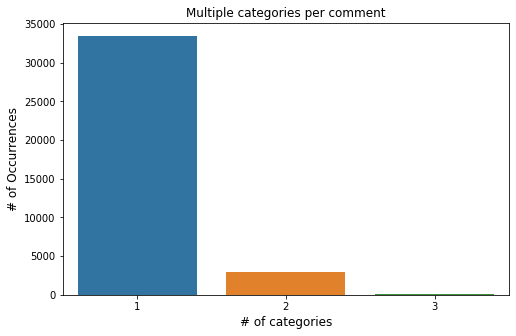

In [ ]:
df_toxic = dataset.drop(['text'], axis=1)
rowsums = df_toxic.sum(axis=1)
x=rowsums.value_counts()
#plot
plt.figure(figsize=(8,5))
ax = sns.barplot(x.index, x.values)
plt.title("Multiple categories per comment")
plt.ylabel('# of Occurrences', fontsize=12)
plt.xlabel('# of categories', fontsize=12)

From the bar chart above, we can say that although majority of the texts have only one emotion label. However, there are other text samples that have more than one emotion label or even have no emotion labels. Hence we will be taking a look at multi-label classification.

In [ ]:
print("X train shape: ",X_train.shape)
print("X test shape: ",X_test.shape)

print("Y train shape: ",y_train.shape)
print("Y test shape: ",y_test.shape)

X train shape:  (25543,)
X test shape:  (10948,)
Y train shape:  (25543, 6)
Y test shape:  (10948, 6)


### **Binary Relevance**

In [ ]:
binary_relevance = Pipeline([('tfidf', TfidfVectorizer(stop_words='english', max_features=1500)),
               ('binary',BinaryRelevance(LogisticRegression(solver='saga',n_jobs=-1)))
              ])

binary_relevance.fit(X_train, y_train)
y_pred = binary_relevance.predict(X_test)
evaluation_metrics(y_test.values.argmax(axis=1), y_pred.argmax(axis=1),binary_relevance,['said hated dont give damn either way'])

confusion matrix: 
 [[1497  146  159  920  412  693]
 [   7   35    2    3    0    0]
 [   3    4   57    4    2    4]
 [ 459   28   31 5042  142  338]
 [  34    8    4   40  325   21]
 [  69    2    4   96   24  333]]

balanced accuracy:  0.6873139971624241

cohen's kappa score:  0.45802559482761995

top 3 predicted labels:  [0]

classification report: 
               precision    recall  f1-score   support

           0       0.72      0.39      0.51      3827
           1       0.16      0.74      0.26        47
           2       0.22      0.77      0.34        74
           3       0.83      0.83      0.83      6040
           4       0.36      0.75      0.49       432
           5       0.24      0.63      0.35       528

    accuracy                           0.67     10948
   macro avg       0.42      0.69      0.46     10948
weighted avg       0.74      0.67      0.67     10948



In [ ]:
calculate_roc_auc(y_test, y_pred.toarray())

One-vs-One ROC AUC scores:
0.648450 (macro),
0.723547 (weighted by prevalence)
One-vs-Rest ROC AUC scores:
0.648450 (macro),
0.723547 (weighted by prevalence)


### **Multioutput Classifier**

In [ ]:
multi_output = Pipeline([('tfidf', TfidfVectorizer(stop_words='english')),
               ('lr_multi',MultiOutputClassifier(LogisticRegression(solver='saga')))
              ])

multi_output.fit(X_train, y_train)
y_pred = multi_output.predict(X_test)
evaluation_metrics(y_test.values.argmax(axis=1), y_pred.argmax(axis=1),multi_output,['said hated dont give damn either way'])

confusion matrix: 
 [[1551  161  168  912  466  746]
 [   5   31    1    2    0    0]
 [   2    2   49    5    1    3]
 [ 441   25   32 5084  139  339]
 [  25    4    3   38  282   16]
 [  45    0    4   64   17  285]]

balanced accuracy:  0.7107587071744877

cohen's kappa score:  0.4550084730570527

top 3 predicted labels:  [[0 1]]

classification report: 
               precision    recall  f1-score   support

           0       0.75      0.39      0.51      4004
           1       0.14      0.79      0.24        39
           2       0.19      0.79      0.31        62
           3       0.83      0.84      0.84      6060
           4       0.31      0.77      0.44       368
           5       0.21      0.69      0.32       415

    accuracy                           0.67     10948
   macro avg       0.40      0.71      0.44     10948
weighted avg       0.75      0.67      0.68     10948



In [ ]:
calculate_roc_auc(y_test, y_pred)

One-vs-One ROC AUC scores:
0.637256 (macro),
0.719840 (weighted by prevalence)
One-vs-Rest ROC AUC scores:
0.637256 (macro),
0.719840 (weighted by prevalence)


# **Baseline Analysis**
From our models above, we can see that TF-IDF is most effective as a text representation. Hence, machine learning algorithms will use TF-IDF as input to perform classification. Among them, Multioutput Classifier generated the highest balanaced accuracy of 71% which will represent our second baseline to improve upon using deep learning.

Hence, we will use deep learning to take a look at the use of different text representations together with different deep learning models to generate better accuracy.
